In [1]:
import torch, torchvision, os, PIL, pdb
from torch import nn
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torch import nn

In [2]:
def show(tensor, num=25, wandbactive=0, name=''):
    data = tensor.detach().cpu()
    grid = make_grid(data[:num], nrow=5).permute(1,2,0)
    plt.imshow(grid.clip(0,1))
    plt.axis(False)
    plt.show()

In [3]:
n_epochs= 100
batch_size=64
lr=1e-4
z_dim=200
device = "cuda"
cur_step=0
crit_cycles=2
gen_losses=[]
crit_losses=[]
show_step=35
save_step=35


In [4]:
def gen_noise(num, z_dim, device='cuda'):
    return torch.randn(num, z_dim, device=device) # 128 x 200


In [5]:
# generator model
# https://medium.com/@ideami

class Generator(nn.Module):
    def __init__(self, z_dim=64, d_dim=16):
        super(Generator, self).__init__()
        self.z_dim=z_dim
        self.gen = nn.Sequential(
            nn.ConvTranspose2d(z_dim, d_dim * 32, 4, 1, 0), 
            nn.BatchNorm2d(d_dim*32),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*32, d_dim*16, 4, 2, 1),
            nn.BatchNorm2d(d_dim*16),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*16, d_dim*8, 4, 2, 1),
            nn.BatchNorm2d(d_dim*8),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*8, d_dim*4, 4, 2, 1),
            nn.BatchNorm2d(d_dim*4),
            nn.ReLU(True),            

            nn.ConvTranspose2d(d_dim*4, d_dim*2, 4, 2, 1),
            nn.BatchNorm2d(d_dim*2),
            nn.ReLU(True),            

            nn.ConvTranspose2d(d_dim*2, 3, 4, 2, 1),
            nn.Tanh() )
    
    def forward(self, noise):
        x=noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

In [6]:
## critic model

class Critic(nn.Module):
    def __init__(self, d_dim=16):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            nn.Conv2d(3, d_dim, 4, 2, 1),
            nn.InstanceNorm2d(d_dim), 
            nn.LeakyReLU(0.2),

            nn.Conv2d(d_dim, d_dim*2, 4, 2, 1),
            nn.InstanceNorm2d(d_dim*2), 
            nn.LeakyReLU(0.2),

            nn.Conv2d(d_dim*2, d_dim*4, 4, 2, 1), 
            nn.InstanceNorm2d(d_dim*4), 
            nn.LeakyReLU(0.2),

            nn.Conv2d(d_dim*4, d_dim*8, 4, 2, 1),
            nn.InstanceNorm2d(d_dim*8), 
            nn.LeakyReLU(0.2),

            nn.Conv2d(d_dim*8, d_dim*16, 4, 2, 1),
            nn.InstanceNorm2d(d_dim*16), 
            nn.LeakyReLU(0.2),

            nn.Conv2d(d_dim*16, 1, 4, 1, 0),
    )
        
    def forward(self, image):
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred),-1)
  

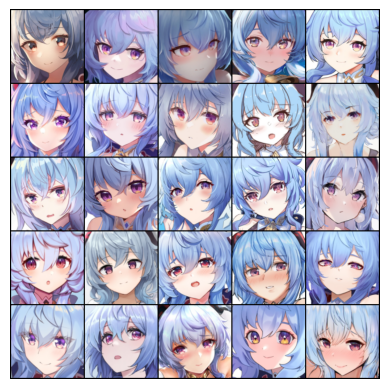

In [7]:
class Dataset(Dataset):
  def __init__(self, path, size=128, lim=10000):
    self.sizes=[size, size]
    items, labels=[],[]

    for data in os.listdir(path)[:lim]:
      #path: './data/celeba/img_align_celeba'
      #data: '114568.jpg
      item = os.path.join(path,data)
      items.append(item)
      labels.append(data)
    self.items=items
    self.labels=labels


  def __len__(self):
    return len(self.items)

  def __getitem__(self,idx):
    data = PIL.Image.open(self.items[idx]).convert('RGB') # (178,218)
    data = np.asarray(torchvision.transforms.Resize(self.sizes)(data)) # 128 x 128 x 3
    data = np.transpose(data, (2,0,1)).astype(np.float32, copy=False) # 3 x 128 x 128 # from 0 to 255
    data = torch.from_numpy(data).div(255) # from 0 to 1
    return data, self.labels[idx]


data_path="/kaggle/input/ganyu-genshin-impact-anime-faces-gan-training/ganyu/ganyu-final"
ds = Dataset(data_path, size=128, lim=10000)
dataloader = DataLoader(ds, batch_size=batch_size, shuffle=True)
gen = Generator(z_dim).to(device)
crit = Critic().to(device)

x,y=next(iter(dataloader))
show(x)


In [8]:
# !git clone https://github.com/kyegomez/Sophia
# %cd Sophia
# from Sophia import SophiaG
# from IPython.display import clear_output
# clear_output()

In [9]:
# gen_opt = SophiaG(gen.parameters(), lr=lr, betas=(0.5,0.9))
# crit_opt= SophiaG(crit.parameters(), lr=lr, betas=(0.5,0.9))
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(0.5,0.9))
crit_opt= torch.optim.Adam(crit.parameters(), lr=lr, betas=(0.5,0.9))

In [10]:


def get_gp(real, fake, crit, alpha, gamma=10):
    mix_images = real * alpha + fake * (1-alpha)
    mix_scores = crit(mix_images)
    gradient = torch.autograd.grad(
      inputs = mix_images,
      outputs = mix_scores,
      grad_outputs=torch.ones_like(mix_scores),
      retain_graph=True,
      create_graph=True)[0]

    gradient = gradient.view(len(gradient), -1)
    gradient_norm = gradient.norm(2, dim=1) 
    gp = gamma * ((gradient_norm-1)**2).mean()
    return gp



  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

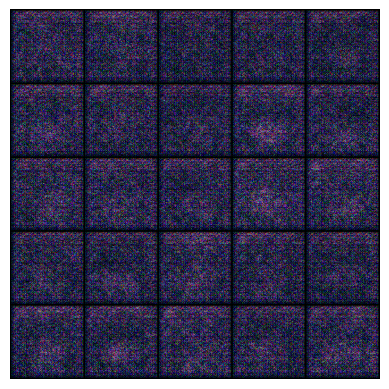

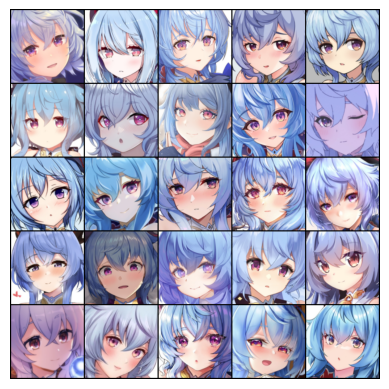

Epoch: 2: Step 35: Generator loss: 0.29404159230845317, critic loss: -1.0029883486883981


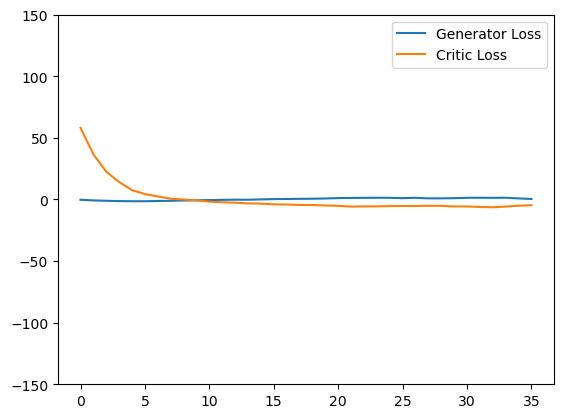

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

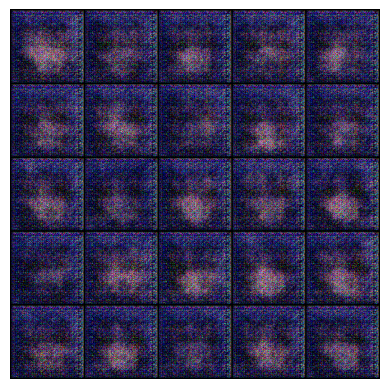

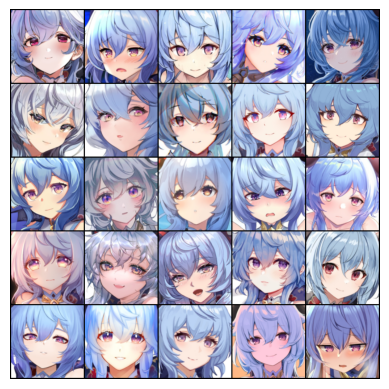

Epoch: 5: Step 70: Generator loss: 2.5232367055756706, critic loss: -7.891266972678048


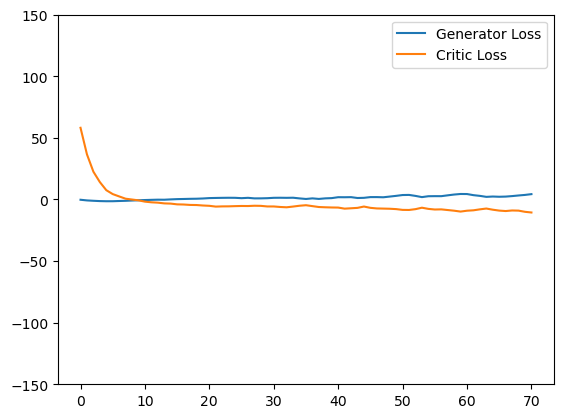

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

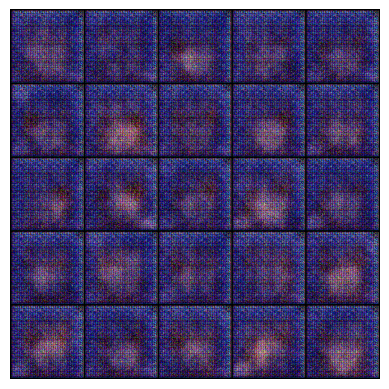

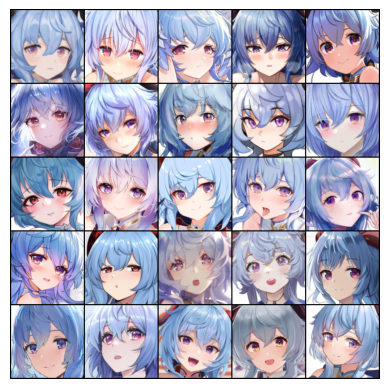

Epoch: 7: Step 105: Generator loss: 4.814498942238944, critic loss: -12.12180916922433


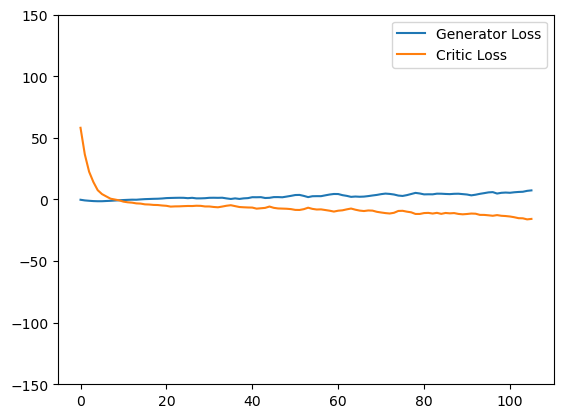

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

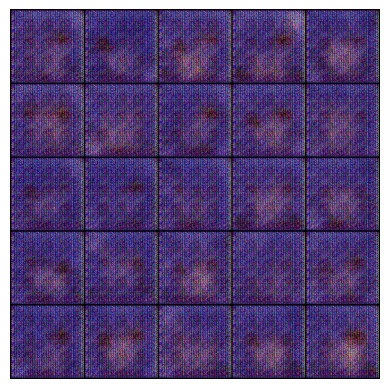

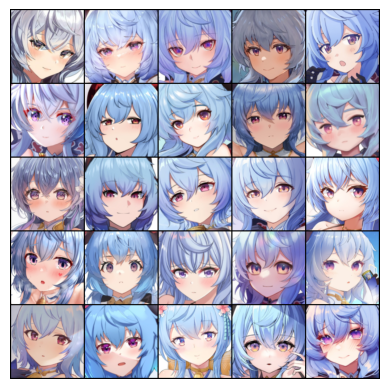

Epoch: 10: Step 140: Generator loss: 6.715208067212786, critic loss: -16.091725948878697


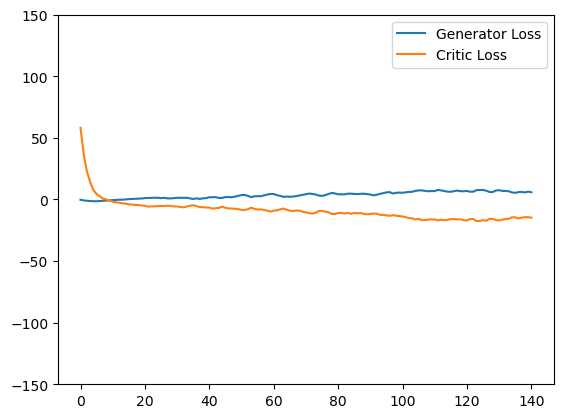

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

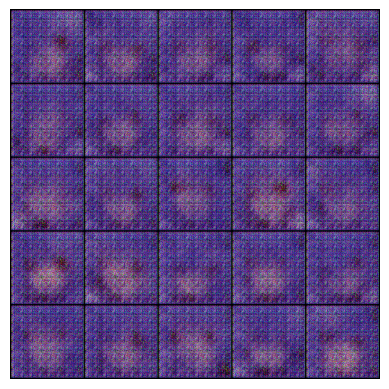

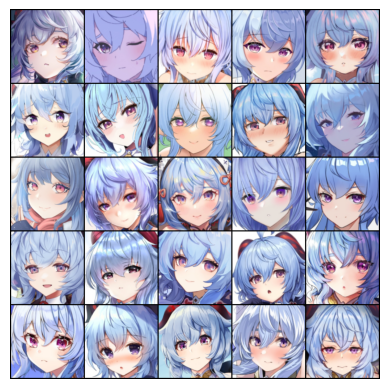

Epoch: 12: Step 175: Generator loss: 6.09702057157244, critic loss: -14.392924240657262


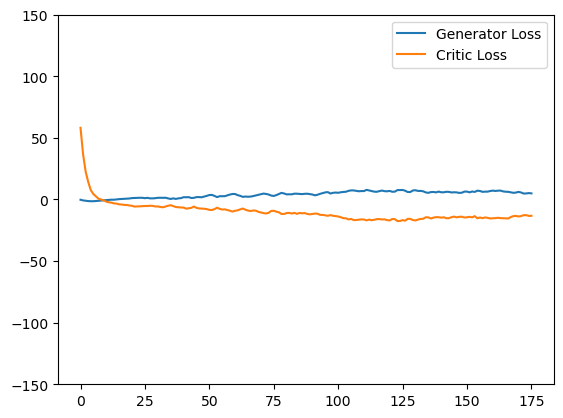

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

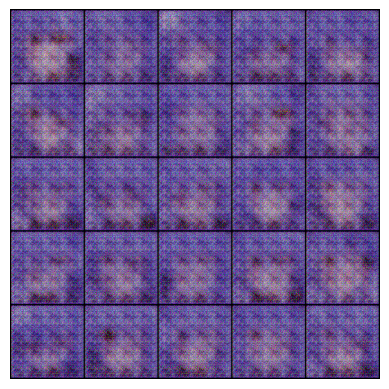

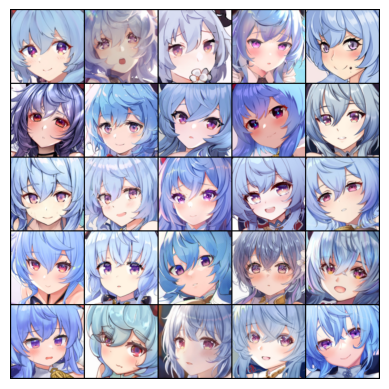

Epoch: 15: Step 210: Generator loss: 3.9049318994794575, critic loss: -9.936339480536324


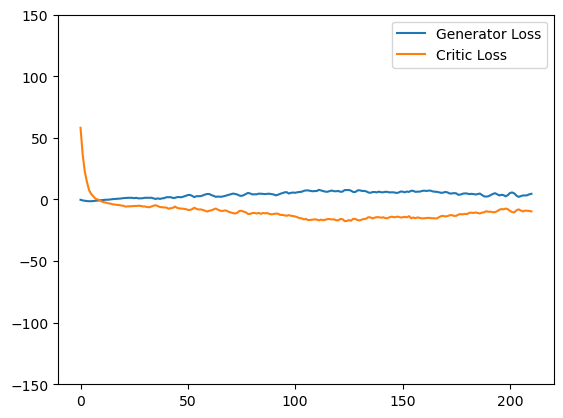

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

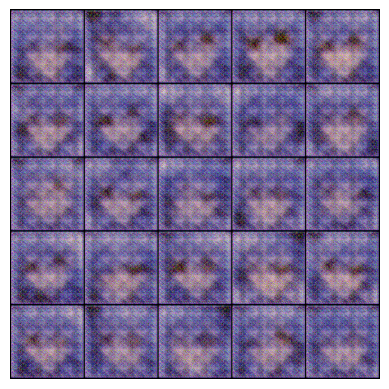

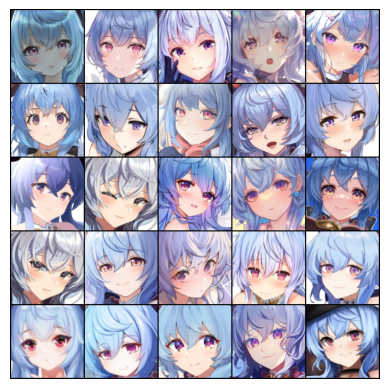

Epoch: 17: Step 245: Generator loss: 3.97725499016898, critic loss: -7.993583679199219


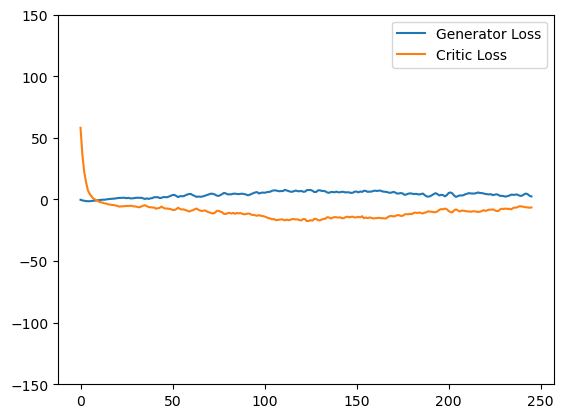

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

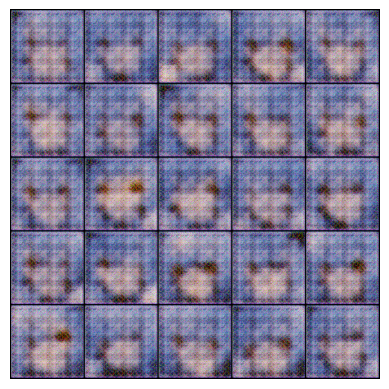

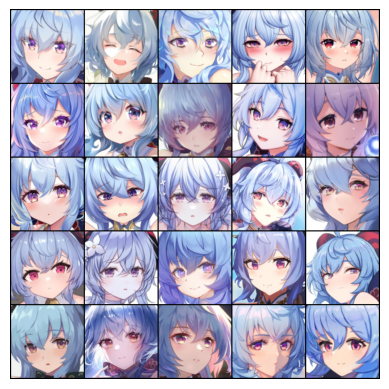

Epoch: 20: Step 280: Generator loss: 3.6570738417761666, critic loss: -6.624051673071725


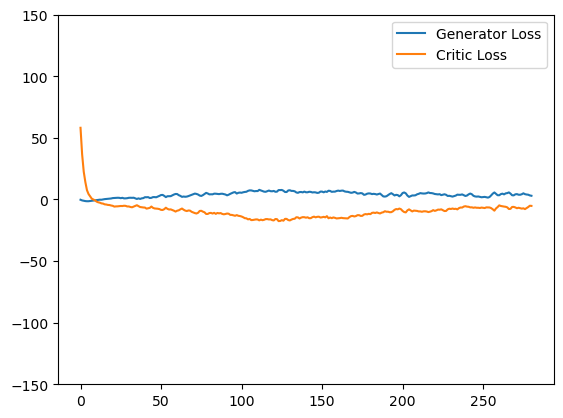

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

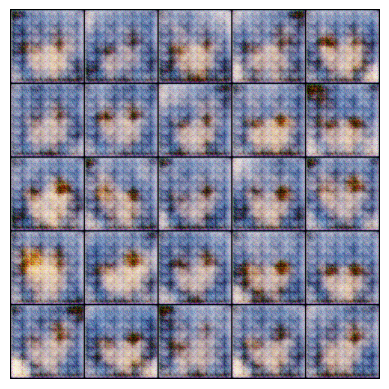

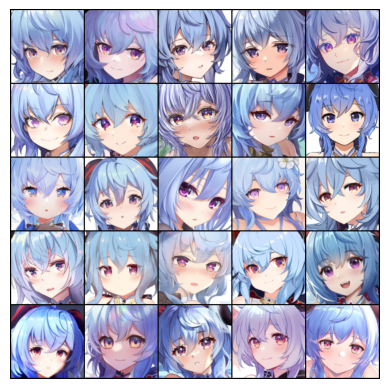

Epoch: 22: Step 315: Generator loss: 4.208827495574951, critic loss: -7.025381108692714


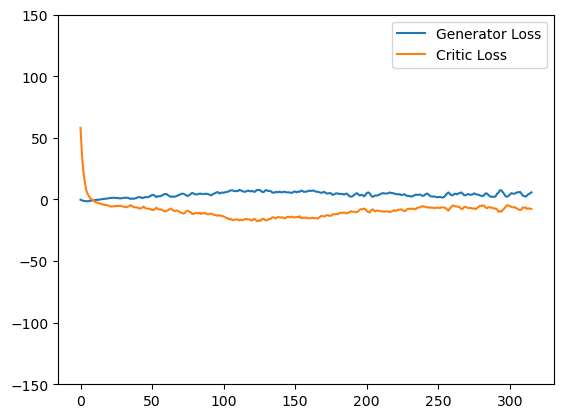

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

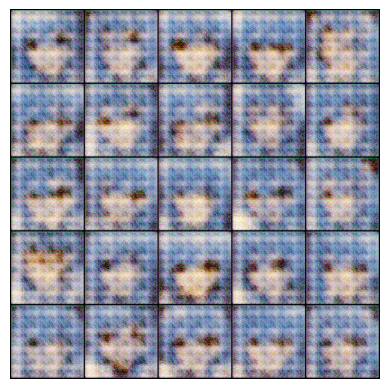

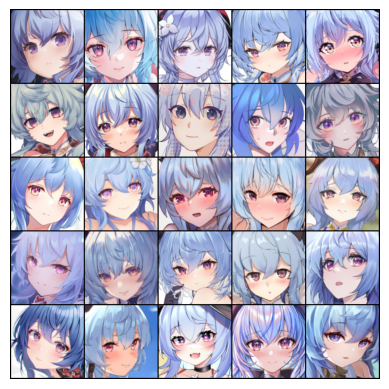

Epoch: 25: Step 350: Generator loss: 4.815033292770385, critic loss: -7.531565754754203


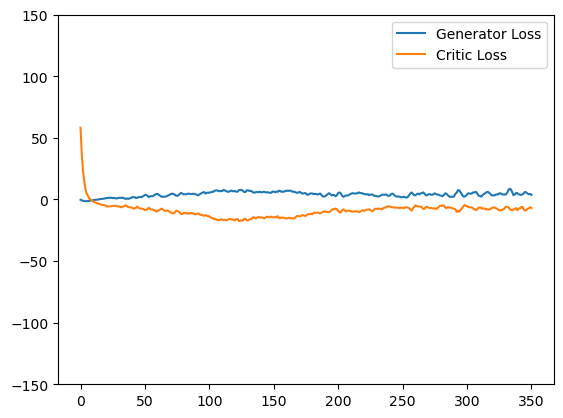

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

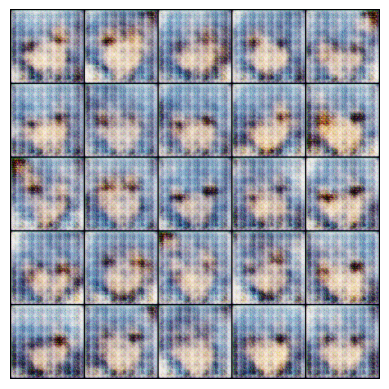

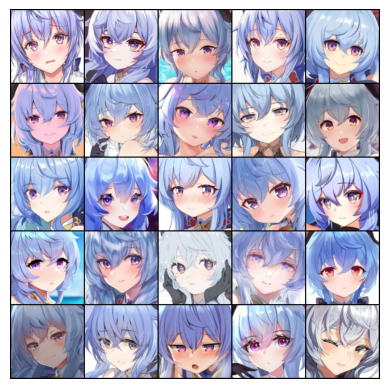

Epoch: 27: Step 385: Generator loss: 4.736967257090977, critic loss: -6.970275504248483


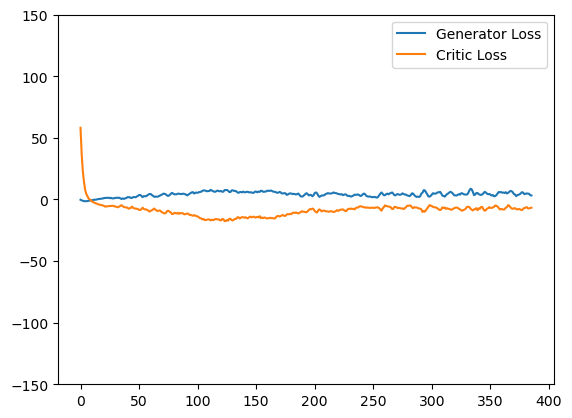

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

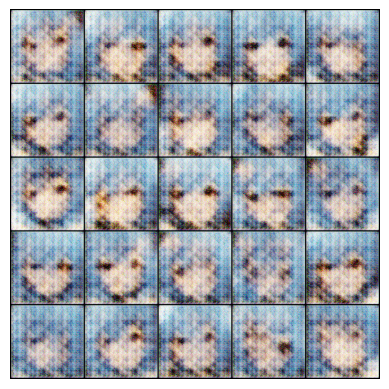

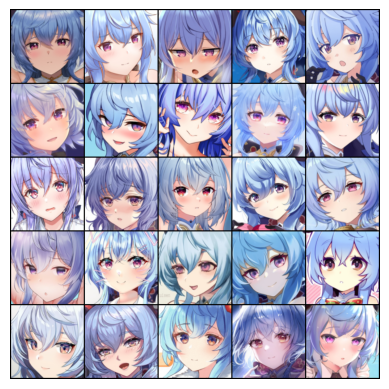

Epoch: 30: Step 420: Generator loss: 4.857376057761056, critic loss: -6.8212028503417965


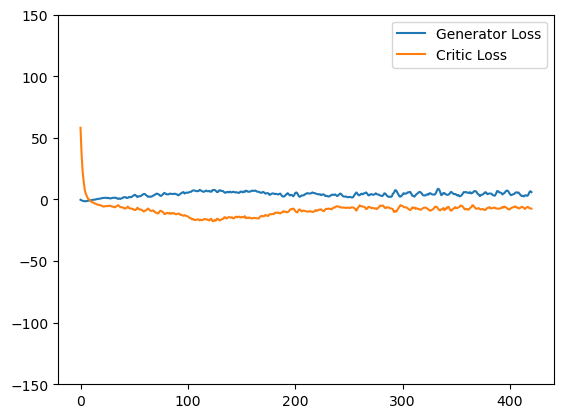

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

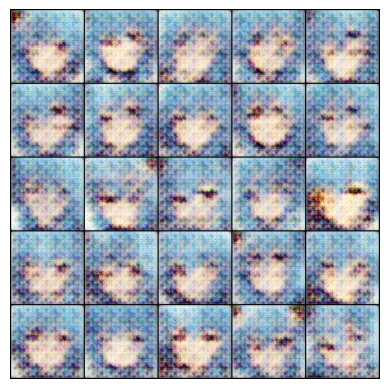

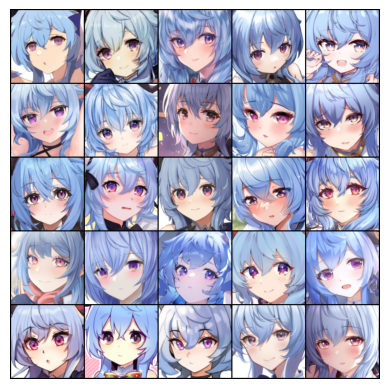

Epoch: 32: Step 455: Generator loss: 5.352607243401664, critic loss: -7.331997421809605


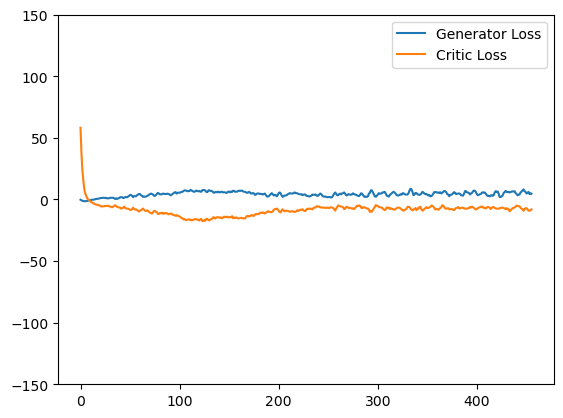

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

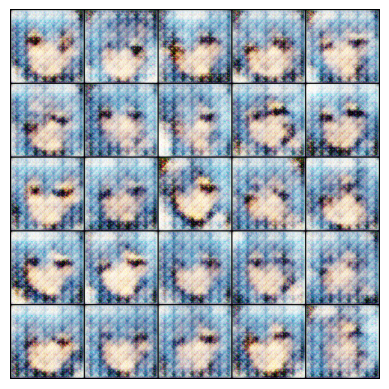

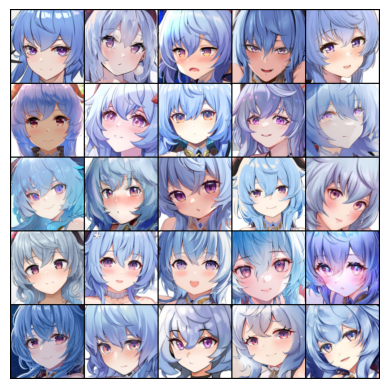

Epoch: 35: Step 490: Generator loss: 6.085387550081525, critic loss: -7.5891284602028986


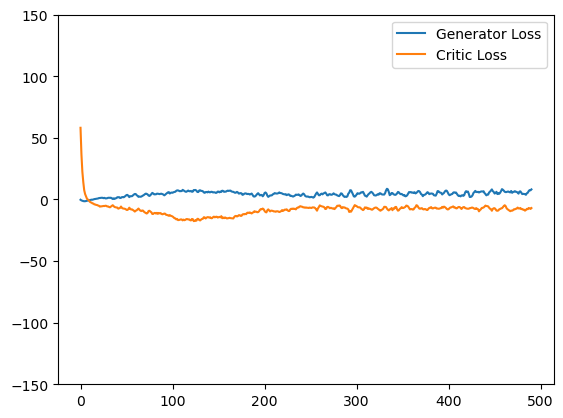

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

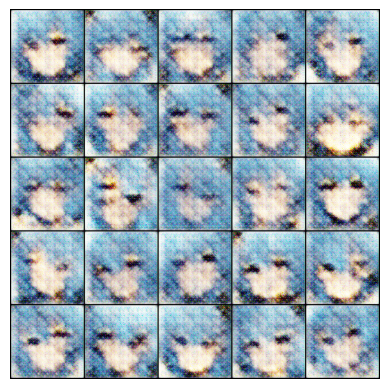

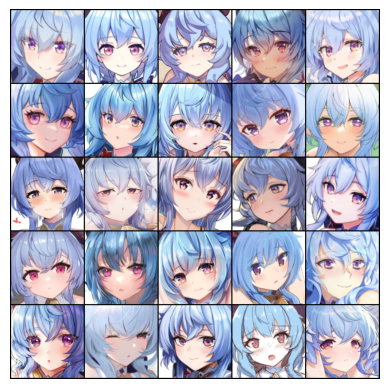

Epoch: 37: Step 525: Generator loss: 5.703524317060198, critic loss: -7.568765912737165


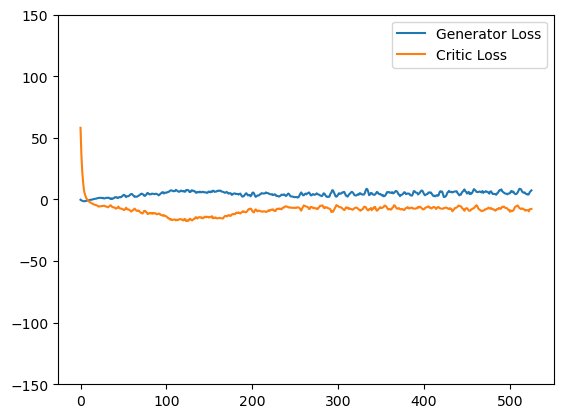

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

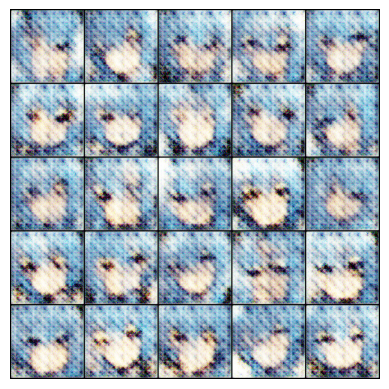

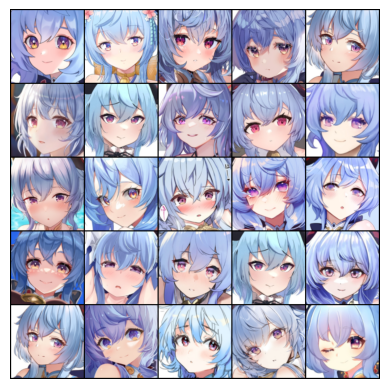

Epoch: 40: Step 560: Generator loss: 6.123594788142613, critic loss: -7.37417436327253


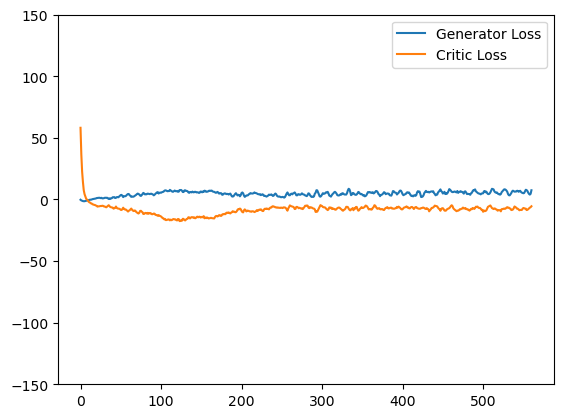

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

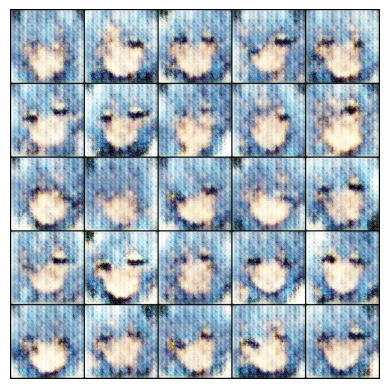

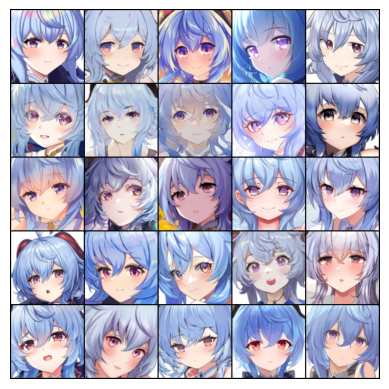

Epoch: 42: Step 595: Generator loss: 6.839110851287842, critic loss: -7.810732569013323


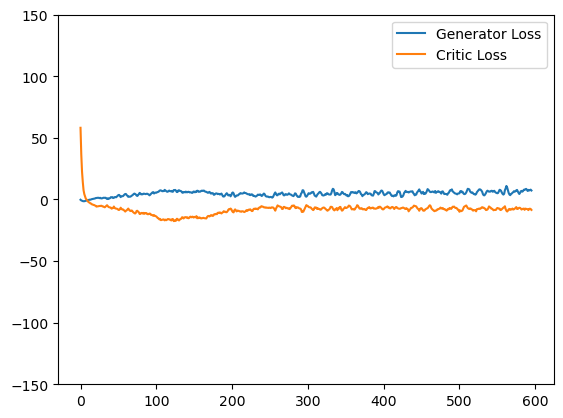

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

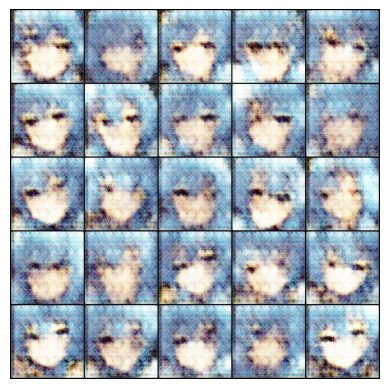

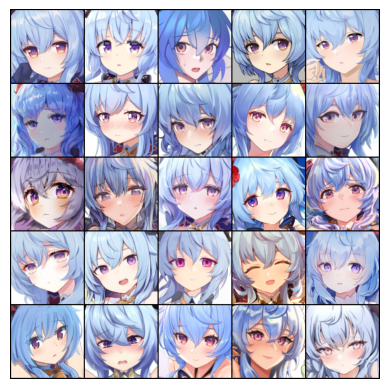

Epoch: 45: Step 630: Generator loss: 7.493875026702881, critic loss: -8.532552773611886


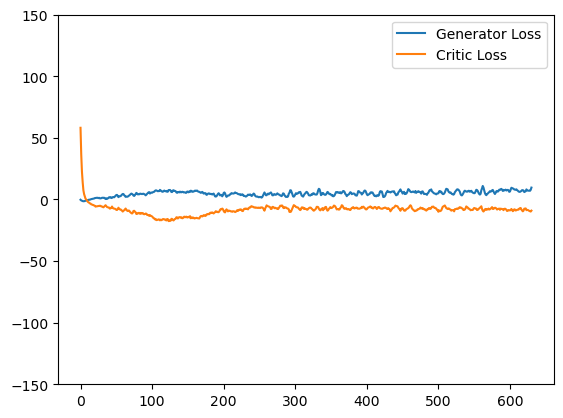

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

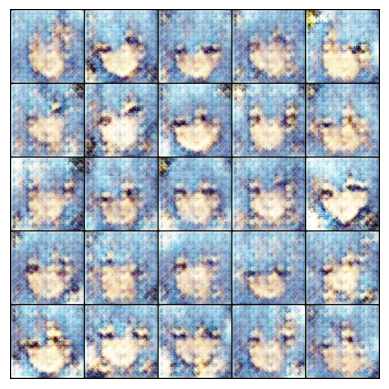

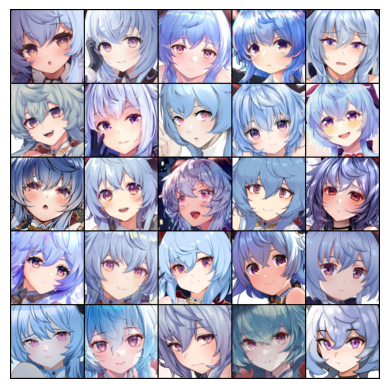

Epoch: 47: Step 665: Generator loss: 6.911995199748448, critic loss: -7.9359231199537


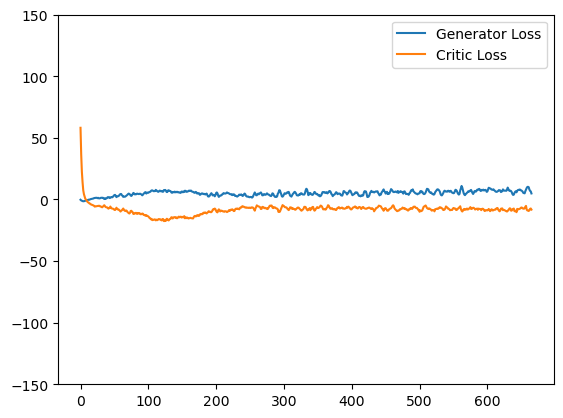

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

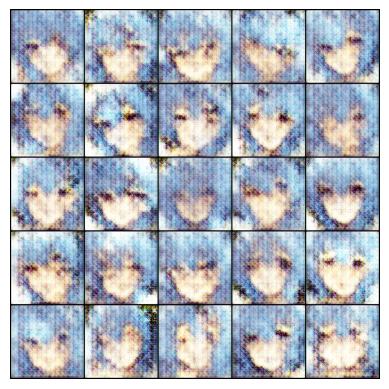

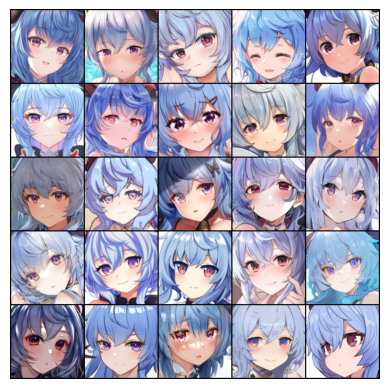

Epoch: 50: Step 700: Generator loss: 7.13412047794887, critic loss: -7.949924101148333


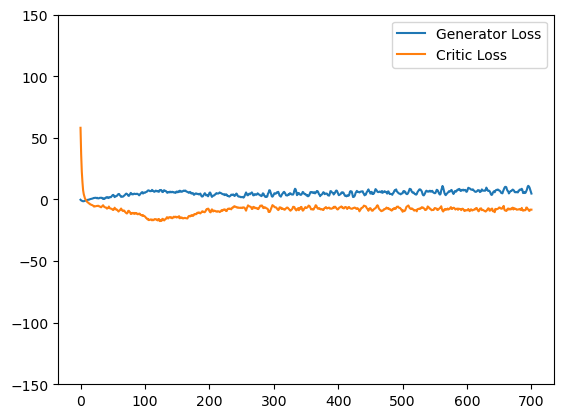

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

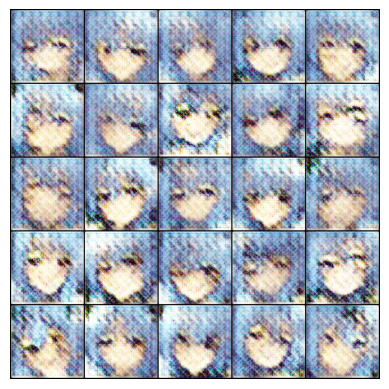

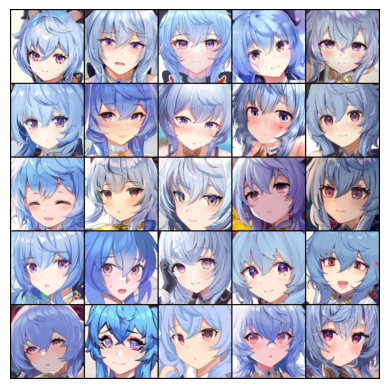

Epoch: 52: Step 735: Generator loss: 7.400530747004917, critic loss: -8.078017902374267


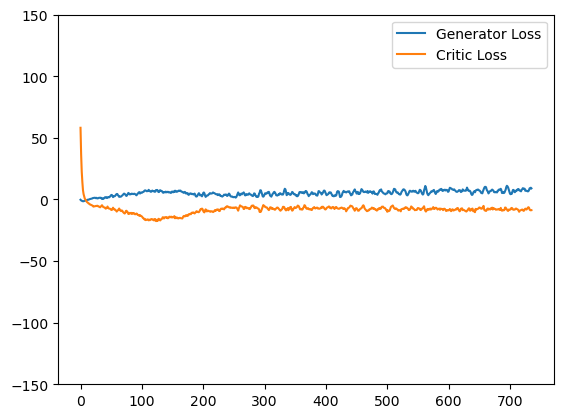

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

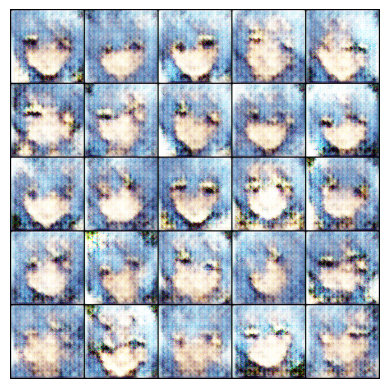

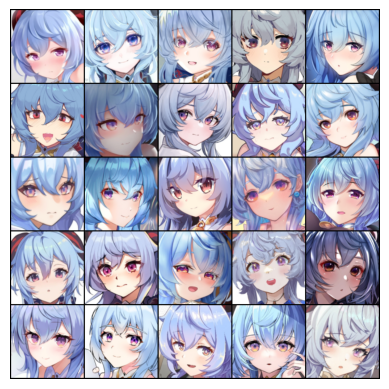

Epoch: 55: Step 770: Generator loss: 7.130873080662319, critic loss: -8.105965205601283


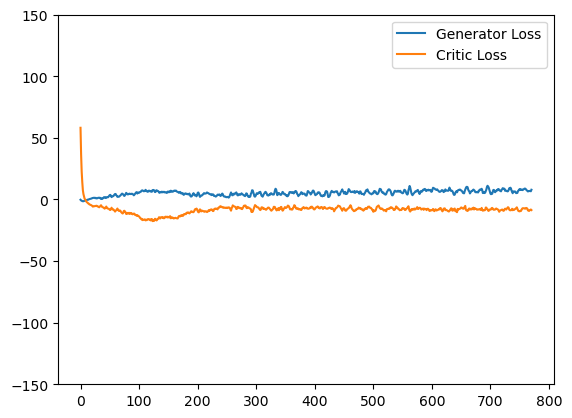

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

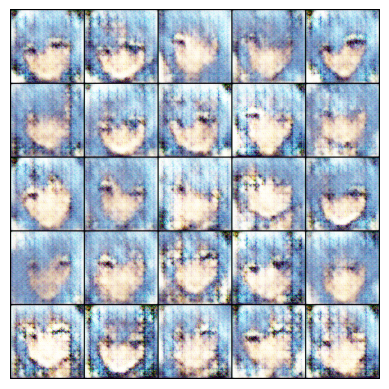

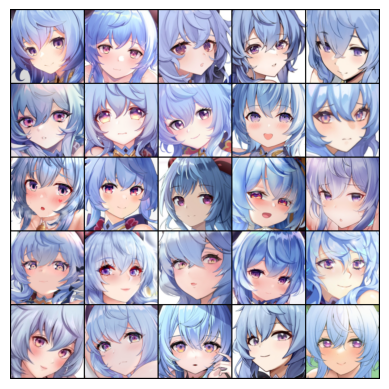

Epoch: 57: Step 805: Generator loss: 6.703731141771589, critic loss: -8.29846819468907


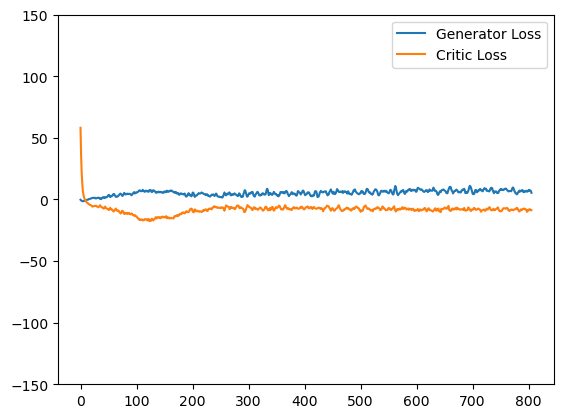

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

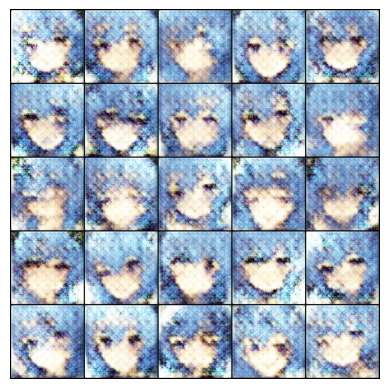

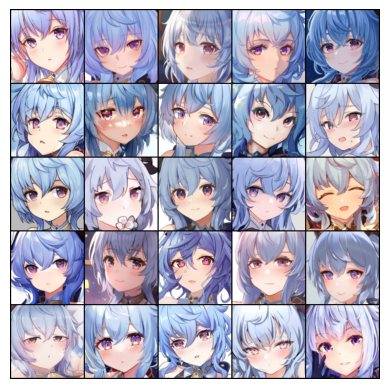

Epoch: 60: Step 840: Generator loss: 6.946773856026786, critic loss: -8.483043915884835


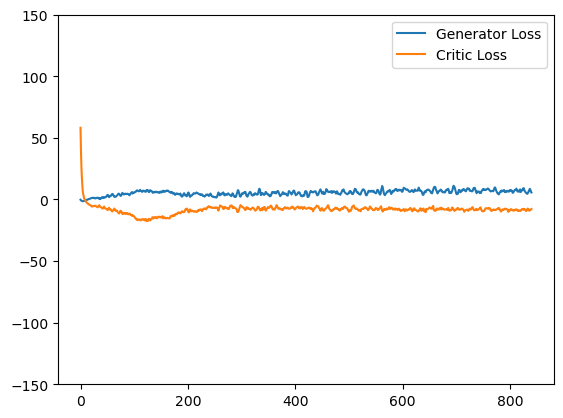

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

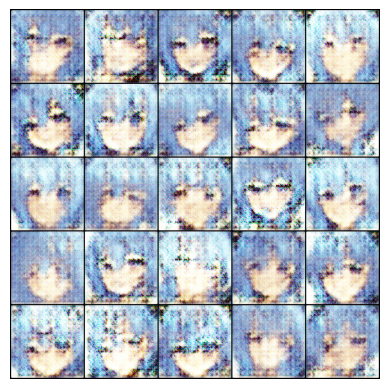

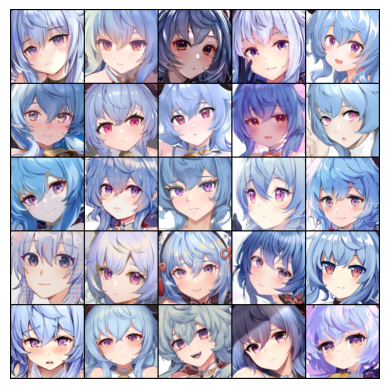

Epoch: 62: Step 875: Generator loss: 6.853557314191546, critic loss: -8.135989155088152


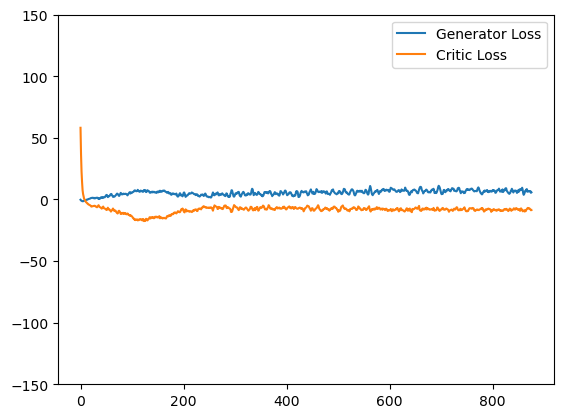

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

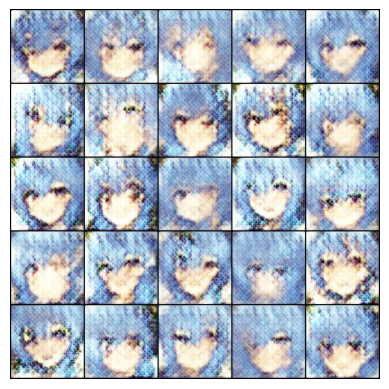

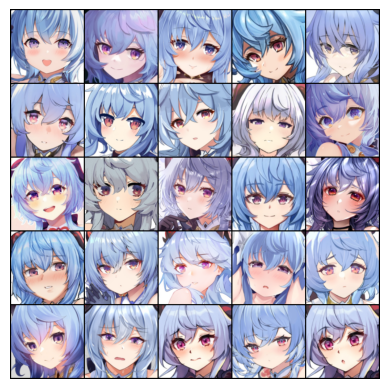

Epoch: 65: Step 910: Generator loss: 6.8239513260977605, critic loss: -8.109842443466187


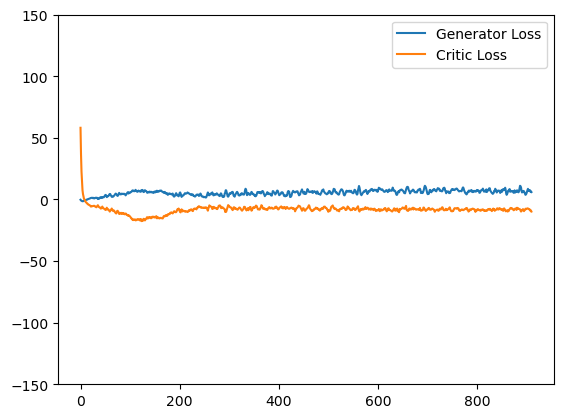

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

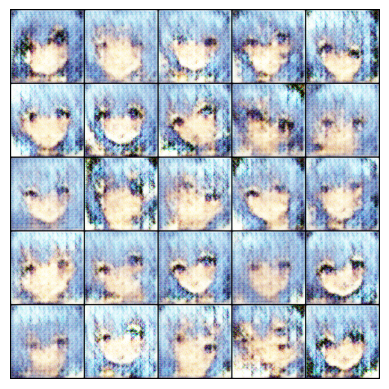

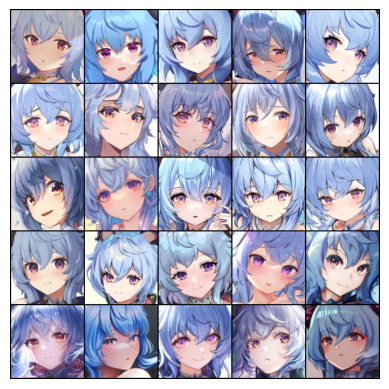

Epoch: 67: Step 945: Generator loss: 6.6579584121704105, critic loss: -7.949633032935006


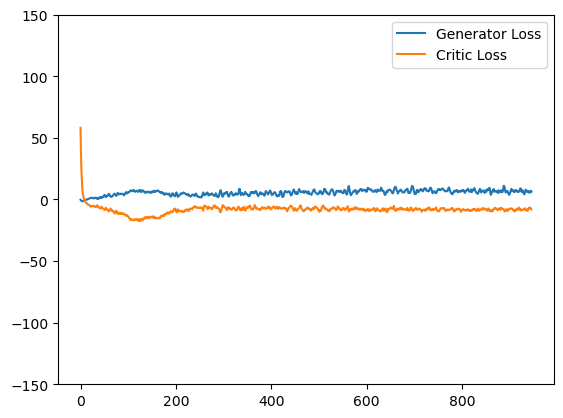

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

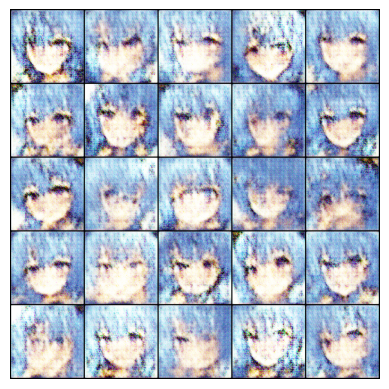

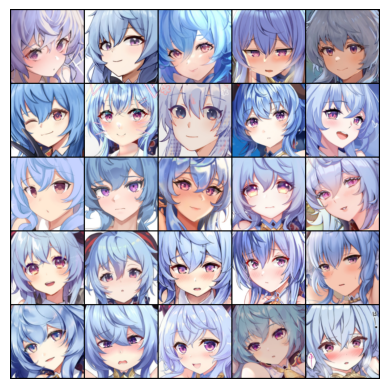

Epoch: 70: Step 980: Generator loss: 6.604424558367048, critic loss: -8.255872583389282


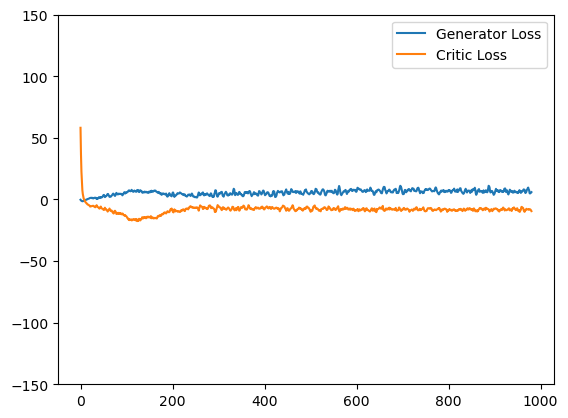

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

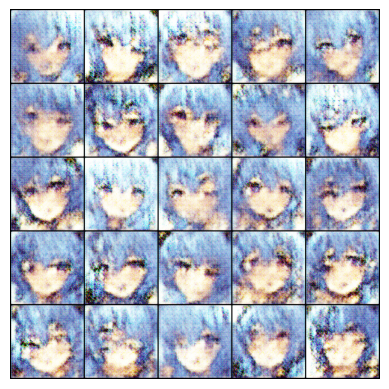

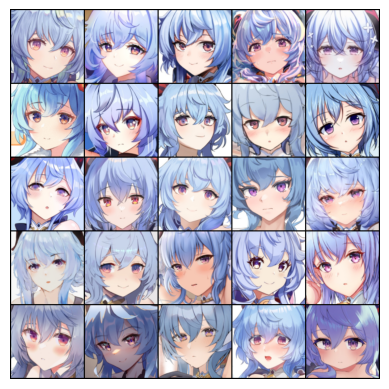

Epoch: 72: Step 1015: Generator loss: 6.229843303135463, critic loss: -7.739415032523019


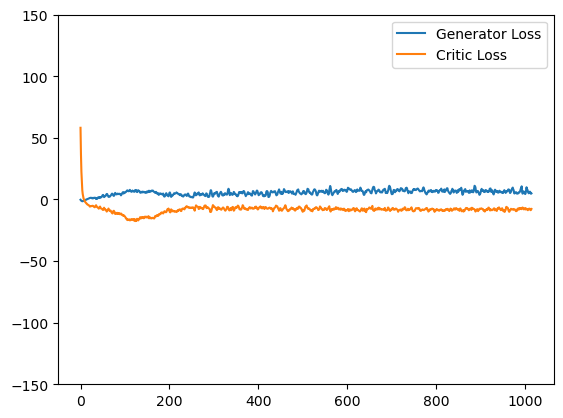

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

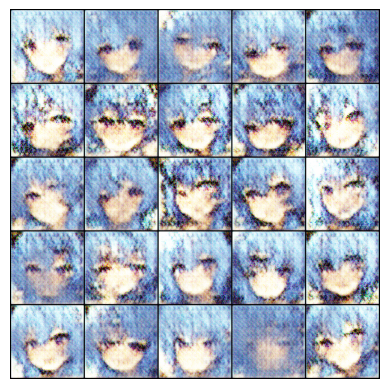

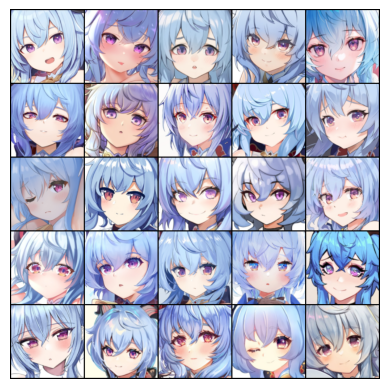

Epoch: 75: Step 1050: Generator loss: 6.385761478969029, critic loss: -7.341841500146049


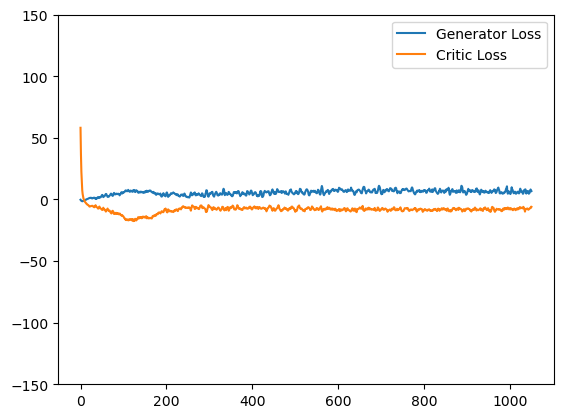

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

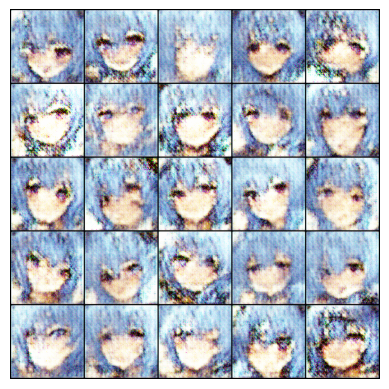

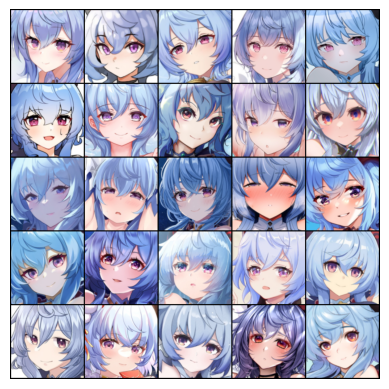

Epoch: 77: Step 1085: Generator loss: 6.197231864929199, critic loss: -7.405293301173619


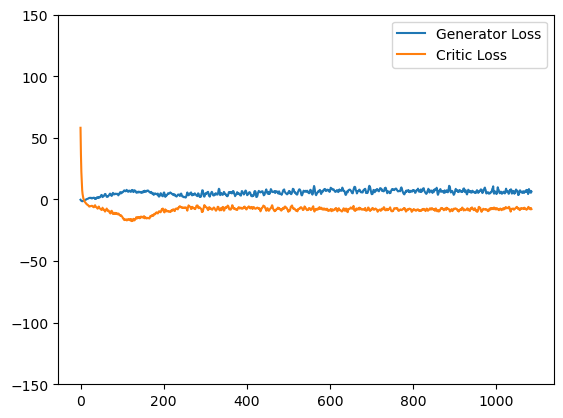

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

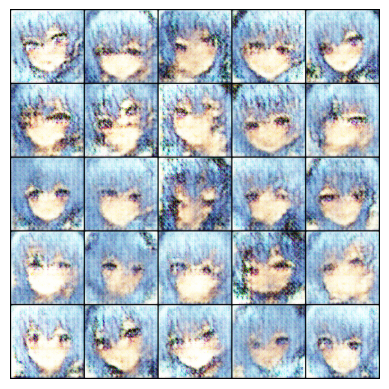

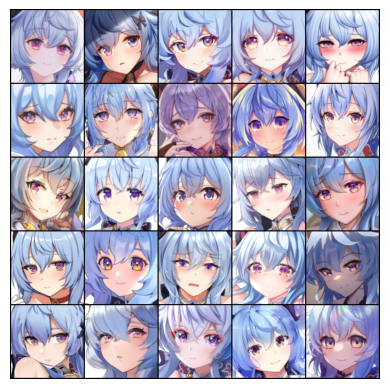

Epoch: 80: Step 1120: Generator loss: 6.232377025059291, critic loss: -7.363851022720337


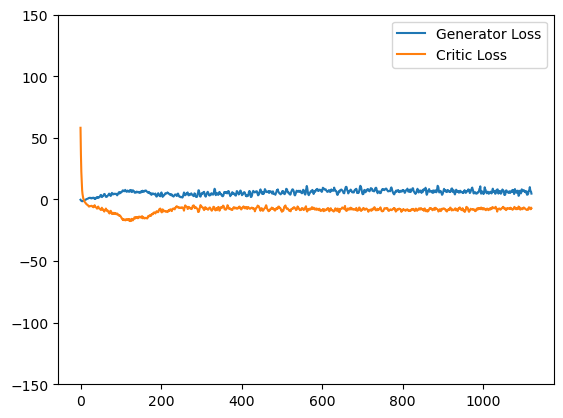

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

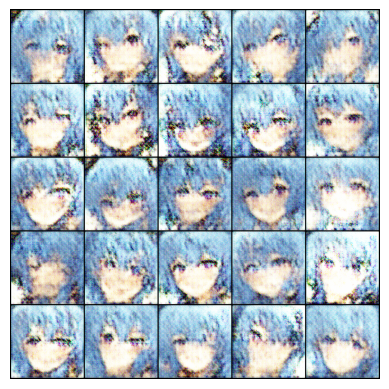

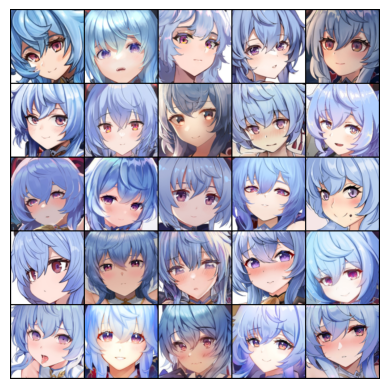

Epoch: 82: Step 1155: Generator loss: 6.284741912569318, critic loss: -7.290846858705793


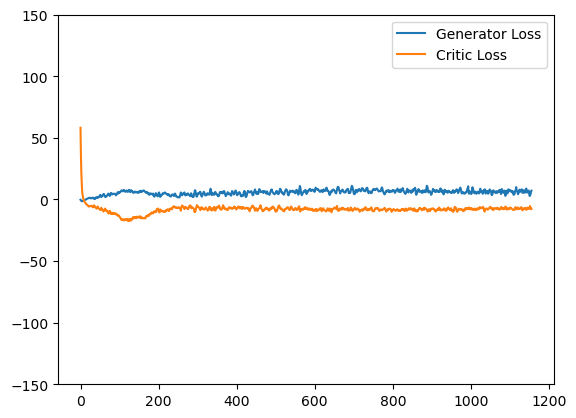

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

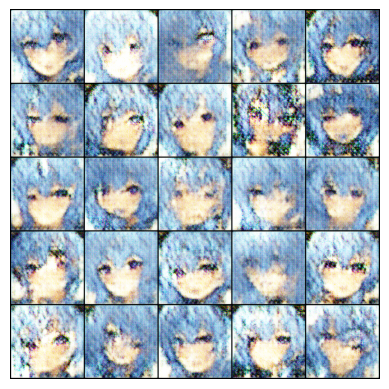

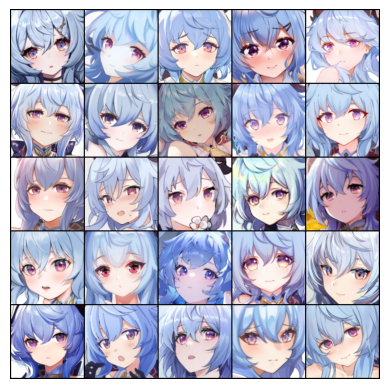

Epoch: 85: Step 1190: Generator loss: 6.489736080169678, critic loss: -7.165857539858137


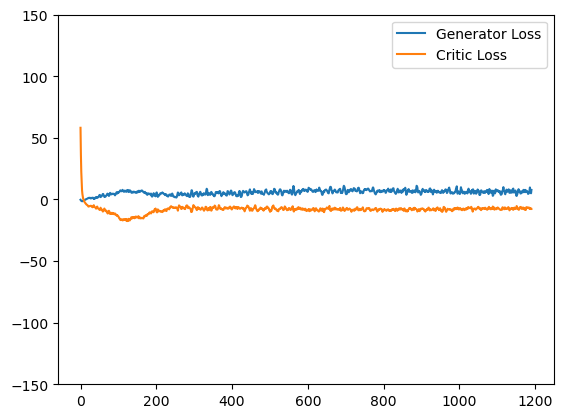

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

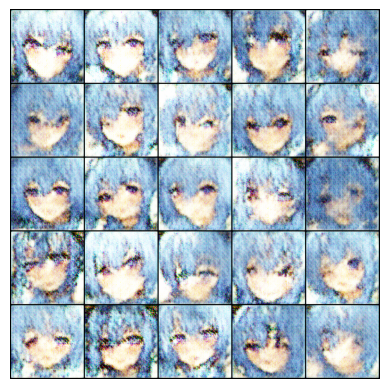

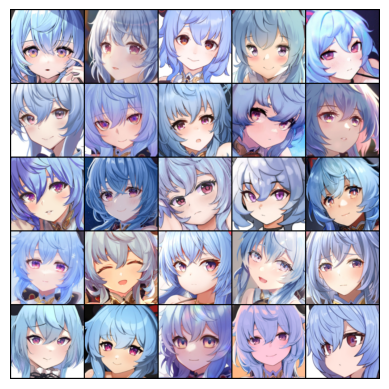

Epoch: 87: Step 1225: Generator loss: 5.943560661588396, critic loss: -7.046923814501081


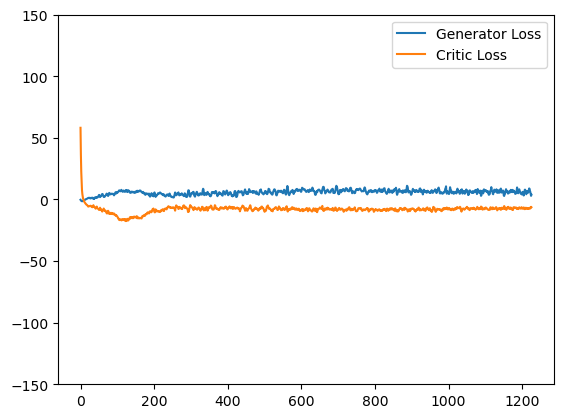

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

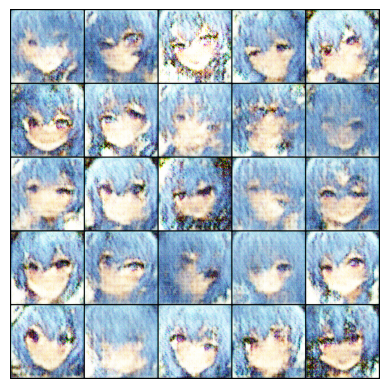

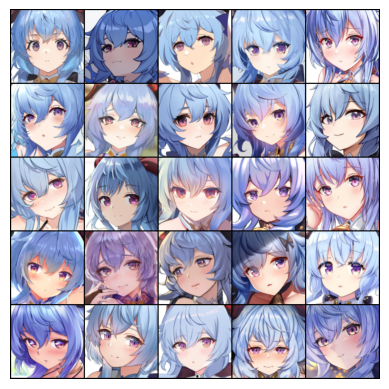

Epoch: 90: Step 1260: Generator loss: 5.833660861424037, critic loss: -7.068722145898001


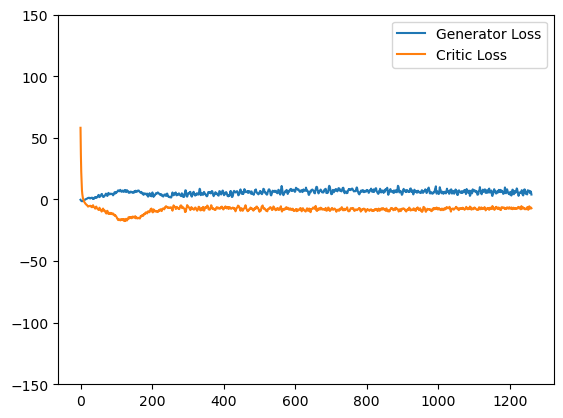

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

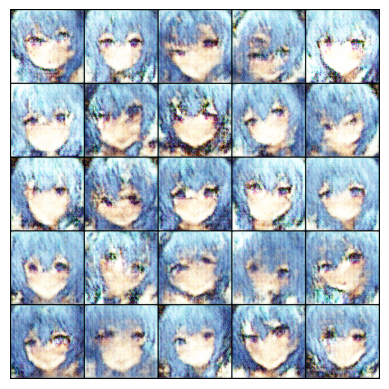

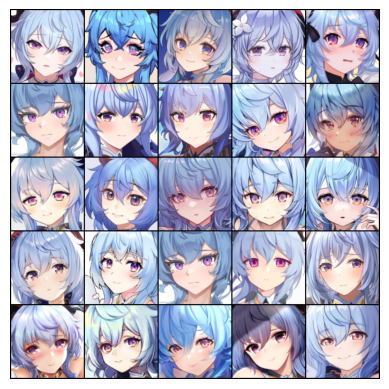

Epoch: 92: Step 1295: Generator loss: 5.952107879093715, critic loss: -7.063567910875593


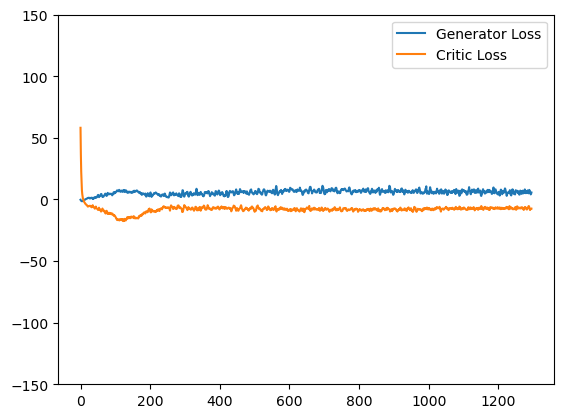

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

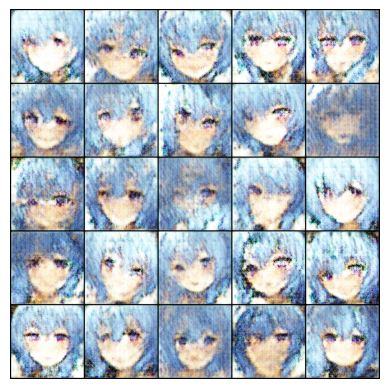

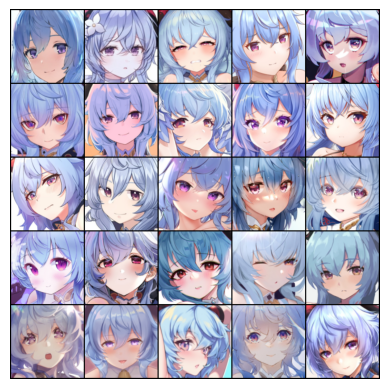

Epoch: 95: Step 1330: Generator loss: 5.76289313180106, critic loss: -7.085666016169957


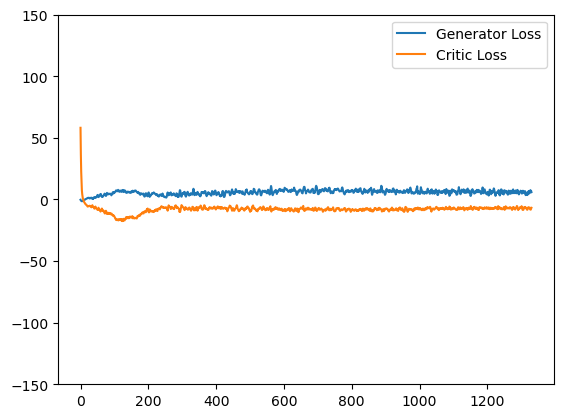

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

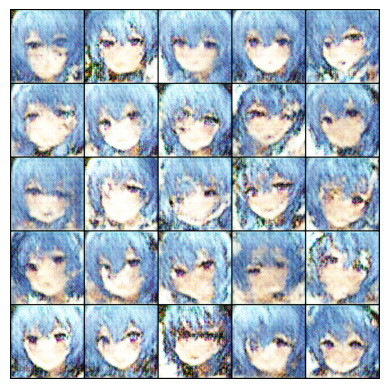

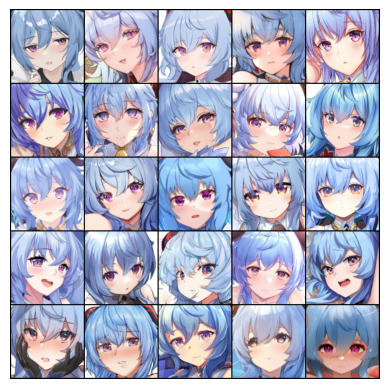

Epoch: 97: Step 1365: Generator loss: 5.783543634414673, critic loss: -7.131071404048375


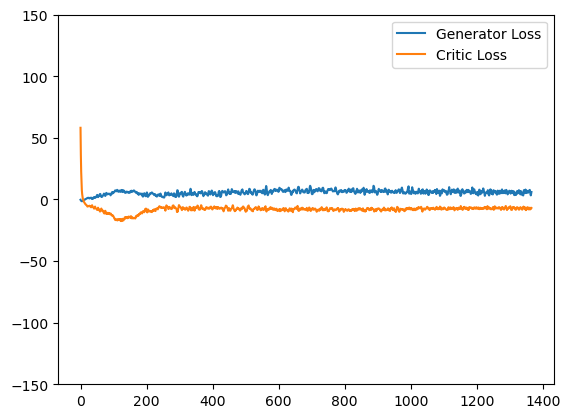

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

In [11]:
for epoch in range(n_epochs):
    for real, _ in tqdm(dataloader):
        cur_bs= len(real) 
        real=real.to(device)
        
        mean_crit_loss = 0
        for _ in range(crit_cycles):
            crit_opt.zero_grad()
            noise=gen_noise(cur_bs, z_dim)
            fake = gen(noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            alpha=torch.rand(len(real),1,1,1,device=device, requires_grad=True) # 128 x 1 x 1 x 1
            gp = get_gp(real, fake.detach(), crit, alpha)
            crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + gp
            mean_crit_loss+=crit_loss.item() / crit_cycles
            crit_loss.backward(retain_graph=True)
            crit_opt.step()
            
        crit_losses+=[mean_crit_loss]
        gen_opt.zero_grad()
        noise = gen_noise(cur_bs, z_dim)
        fake = gen(noise)
        crit_fake_pred = crit(fake)
        gen_loss = -crit_fake_pred.mean()
        gen_loss.backward()
        
        gen_opt.step()
        
        gen_losses+=[gen_loss.item()]
        if (cur_step % show_step == 0 and cur_step > 0):
            show(fake, name='fake')
            show(real, name='real')
            gen_mean=sum(gen_losses[-show_step:]) / show_step
            crit_mean = sum(crit_losses[-show_step:]) / show_step
            print(f"Epoch: {epoch}: Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            
            plt.plot( 
                range(len(gen_losses)),
                torch.Tensor(gen_losses),
                label="Generator Loss")
            
            plt.plot(range(len(gen_losses)),
                     torch.Tensor(crit_losses),
                     label="Critic Loss")
            
            plt.ylim(-150,150)
            plt.legend()

            
            plt.show()
    
        cur_step+=1
